# uGAN_S1_v3_br2021
* filtre = 24
* n_patch = 1
* lr = dynamic
* alpha = 5

In [1]:
! pip install elasticdeform
! pip install tensorflow_addons
! pip install gdown
# ! pip install itk
# ! pip install itkwidgets

     |████████████████████████████████| 93 kB 517 kB/s            
  Installing build dependencies ... - \ | / - done
  Getting requirements to build wheel ... - \ | / - done
  Preparing metadata (pyproject.toml) ... - \ | / - \ done
  Created wheel for gdown: filename=gdown-4.4.0-py3-none-any.whl size=14759 sha256=362e31e348c186d5dfe98274b0833a47c6f5b0d1d64088484def84db963ba129
  Stored in directory: /root/.cache/pip/wheels/fb/c3/0e/c4d8ff8bfcb0461afff199471449f642179b74968c15b7a69c
Successfully built gdown


In [2]:
import gdown

inputs_file = 'https://drive.google.com/file/d/1EBUgs36Ra98ixv4WBI6FZmowso65ci94/view?usp=sharing'
inputs_url = 'https://drive.google.com/uc?id=1EBUgs36Ra98ixv4WBI6FZmowso65ci94'


inputs_output = 'inputs.zip'

gdown.download(inputs_url, inputs_output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1EBUgs36Ra98ixv4WBI6FZmowso65ci94
To: /kaggle/working/inputs.zip
100%|██████████| 414M/414M [00:06<00:00, 68.7MB/s]


'inputs.zip'

In [3]:
! unzip ./inputs.zip -d ./INPUTS
! mv -v ./INPUTS/content/drive/MyDrive/GANs/BrainTumorDetection/INPUTS_EVAL/* ./INPUTS
! rm -rf ./INPUTS/content
! rm ./inputs.zip

Archive:  ./inputs.zip
  inflating: ./INPUTS/content/drive/MyDrive/GANs/BrainTumorDetection/INPUTS_EVAL/class_weights.npy  
  inflating: ./INPUTS/content/drive/MyDrive/GANs/BrainTumorDetection/INPUTS_EVAL/split.json  
  inflating: ./INPUTS/content/drive/MyDrive/GANs/BrainTumorDetection/INPUTS_EVAL/split_nass_Generator.h5  
renamed './INPUTS/content/drive/MyDrive/GANs/BrainTumorDetection/INPUTS_EVAL/class_weights.npy' -> './INPUTS/class_weights.npy'
renamed './INPUTS/content/drive/MyDrive/GANs/BrainTumorDetection/INPUTS_EVAL/split.json' -> './INPUTS/split.json'
renamed './INPUTS/content/drive/MyDrive/GANs/BrainTumorDetection/INPUTS_EVAL/split_nass_Generator.h5' -> './INPUTS/split_nass_Generator.h5'


In [4]:
EXEC = 1
kze=4
VERSION = 'eval_brats21'

INPUT_PATH = './INPUTS'

PATH = './RESULTS' 

DATA_PATH = './data'

In [5]:
if EXEC!=1:
    results_file = 'https://drive.google.com/file/d/10jd2xXbL5SbADb0aco2KSYgR5GCuCU_I/view?usp=sharing'
    results_url = 'https://drive.google.com/uc?id=10jd2xXbL5SbADb0aco2KSYgR5GCuCU_I'

    results_output = 'results.zip'

    gdown.download(results_url, results_output, quiet=False)
    
else:
    ! mkdir ./RESULTS

In [6]:
if EXEC!=1:
    ! unzip ./results.zip -d ./RESULTS
    ! mv -v ./RESULTS/content/drive/MyDrive/GANs/BrainTumorDetection/RESULTS_KAGGLE/VERSION_$VERSION/RESULTS_{EXEC-1}/* ./RESULTS
    ! rm -rf ./RESULTS/content
    ! rm ./results.zip  

In [7]:
import tensorflow as tf
import numpy as np
import tarfile
import nibabel as nib
import glob
import time
from tensorflow import keras
from tensorflow.keras.utils import to_categorical
from sys import stdout
import matplotlib.pyplot as plt
import matplotlib.image as mpim
from scipy.ndimage.interpolation import affine_transform
from sklearn.model_selection import train_test_split
import json

In [8]:
#PATCH EXTRACTION AND AUGMENTATION technique

import numpy as np
from scipy.ndimage.interpolation import affine_transform
import elasticdeform
import multiprocessing as mp

def patch_extraction(Xb, yb, sizePatches=128, Npatches=1, max_tries = 50, background_threshold=0.95, num_classes=4, apply_ratio=False):
    """
    3D patch extraction
    """
    
    batch_size, rows, columns, slices, channels = Xb.shape
    X_patches = np.empty((batch_size*Npatches, sizePatches, sizePatches, sizePatches, channels))
    y_patches = np.empty((batch_size*Npatches, sizePatches, sizePatches, sizePatches))
    i = 0
    list_id = []
    
    if apply_ratio:
      #print(f'Application of ratio(bg_ratio < {background_threshold*100}%): {apply_ratio}')
      for b in range(batch_size):
          for p in range(Npatches):
              
              temp_X = None
              temp_y = None

              tries = 0
              out = False    
              while (tries < max_tries) and (not out):
                #choisir une position aléatoire a partir de la quelle le patch commence
                x = np.random.randint(rows-sizePatches+1) 
                y = np.random.randint(columns-sizePatches+1)
                z = np.random.randint(slices-sizePatches+1) 

                # extraire le patch du cerveau 
                temp_X = Xb[b, x:x+sizePatches, y:y+sizePatches, z:z+sizePatches, :]

                # extraire le patch de la segmentation
                temp_y = yb[b, x:x+sizePatches, y:y+sizePatches, z:z+sizePatches]

                # One-hot Encoding
                temp_y_cat = keras.utils.to_categorical(temp_y, num_classes=num_classes)
                
                # calculer le ratio du background si il est en dessous du background_threshold on garde le patch
                bgrd_ratio = np.sum(temp_y_cat[:, :, :, 0])/(sizePatches * sizePatches * sizePatches)

                tries += 1

                if bgrd_ratio < background_threshold:
                  out = True
                  temp_X = Xb[b, x:x+sizePatches, y:y+sizePatches, z:z+sizePatches, :]

              #print(f'\nBG_ratio : {bgrd_ratio*100} %')
              #print(f"\nTried {tries} times to find a sub-volume. Giving up...")
              X_patches[i] = temp_X
              y_patches[i] = temp_y
              i += 1

    else:
      for b in range(batch_size):
        for p in range(Npatches):
            x = np.random.randint(rows-sizePatches+1) 
            y = np.random.randint(columns-sizePatches+1)
            z = np.random.randint(slices-sizePatches+1) 

            X_patches[i] = Xb[b, x:x+sizePatches, y:y+sizePatches, z:z+sizePatches, :]
            y_patches[i] = yb[b, x:x+sizePatches, y:y+sizePatches, z:z+sizePatches]
            i += 1
                              
    return X_patches, y_patches

def flip3D(X, y):
    """
    Flip the 3D image respect one of the 3 axis chosen randomly
    """
    choice = np.random.randint(3)
    if choice == 0: # flip on x
        X_flip, y_flip = X[::-1, :, :, :], y[::-1, :, :]
    if choice == 1: # flip on y
        X_flip, y_flip = X[:, ::-1, :, :], y[:, ::-1, :]
    if choice == 2: # flip on z
        X_flip, y_flip = X[:, :, ::-1, :], y[:, :, ::-1]
        
    return X_flip, y_flip


def rotation3D(X, y):
    """
    Rotate a 3D image with alfa, beta and gamma degree respect the axis x, y and z respectively.
    The three angles are chosen randomly between 0-30 degrees
    """
    alpha, beta, gamma = np.pi*np.random.random_sample(3,)/6
    Rx = np.array([[1, 0, 0],
                   [0, np.cos(alpha), -np.sin(alpha)],
                   [0, np.sin(alpha), np.cos(alpha)]])
    
    Ry = np.array([[np.cos(beta), 0, np.sin(beta)],
                   [0, 1, 0],
                   [-np.sin(beta), 0, np.cos(beta)]])
    
    Rz = np.array([[np.cos(gamma), -np.sin(gamma), 0],
                   [np.sin(gamma), np.cos(gamma), 0],
                   [0, 0, 1]])
    
    R = np.dot(np.dot(Rx, Ry), Rz)
    
    X_rot = np.empty_like(X)
    for channel in range(X.shape[-1]):
        X_rot[:,:,:,channel] = affine_transform(X[:,:,:,channel], R, offset=0, order=3, mode='constant')
    y_rot = affine_transform(y, R, offset=0, order=0, mode='constant')
    
    del(Rx, Ry, Rz, R)
    return X_rot, y_rot

def brightness(X, y):
    """
    Changing the brighness of a image using power-law gamma transformation.
    Gain and gamma are chosen randomly for each image channel.
    
    Gain chosen between [0.9 - 1.1]
    Gamma chosen between [0.9 - 1.1]
    
    new_im = gain * im^gamma
    """
    
    X_new = np.zeros(X.shape)
    for c in range(X.shape[-1]):
        im = X[:,:,:,c]        
        gain, gamma = (1.2 - 0.8) * np.random.random_sample(2,) + 0.8
        im_new = np.sign(im)*gain*(np.abs(im)**gamma)
        X_new[:,:,:,c] = im_new 
        
    del(im, gain, gamma, im_new)
    return X_new, y

def elastic(X, y):
    """
    Elastic deformation on a image and its target
    """  
    [Xel, yel] = elasticdeform.deform_random_grid([X, y], sigma=2, axis=[(0, 1, 2), (0, 1, 2)], order=[1, 0], mode='constant')
    
    return Xel, yel

def random_decisions(N):
    """
    Generate N random decisions for augmentation
    N should be equal to the batch size
    """
    
    decisions = np.zeros((N, 4)) # 4 is number of aug techniques to combine (patch extraction excluded)
    for n in range(N):
        decisions[n] = np.random.randint(2, size=4)
        
    return decisions

def combine_aug(X, y, do):
    """
    Combine randomly the different augmentation techniques written above
    """
    Xnew, ynew = X, y
    
    # make sure to use at least the 25% of original images
    if np.random.random_sample()>0.75:
        return Xnew, ynew
    
    else:   
        if do[0] == 1:
            Xnew, ynew = flip3D(Xnew, ynew)

        if do[1] == 1:
            Xnew, ynew = brightness(Xnew, ynew)   

        if do[2] == 1:
            Xnew, ynew = flip3D(Xnew, ynew)

        if do[3] == 1:
            Xnew, ynew = elastic(Xnew, ynew)
        
        return Xnew, ynew

def aug_batch(Xb, Yb):
    """
    Generate a augmented image batch 
    """
    batch_size = len(Xb)
    newXb, newYb = np.empty_like(Xb), np.empty_like(Yb)
    
    decisions = random_decisions(batch_size)            
    inputs = [(X, y, do) for X, y, do in zip(Xb, Yb, decisions)]
    pool = mp.Pool(processes=8)
    multi_result = pool.starmap(combine_aug, inputs)
    pool.close()
    
    for i in range(len(Xb)):
        newXb[i], newYb[i] = multi_result[i][0], multi_result[i][1]
    
    del(decisions, inputs, multi_result, pool)
    return newXb, newYb 

In [9]:
#load les imags et appliquer les augmentation

import os
import numpy as np
import tensorflow as tf
import nibabel as nib
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt

def load_img(img_files):
    ''' Load one image and its target form file
    '''
    N = len(img_files)
    # target
    y = nib.load(img_files[N-1]).get_fdata(dtype='float32', caching='unchanged')
    y = y[40:200,34:226,8:136]
    y[y==4]=3
      
    X_norm = np.empty((240, 240, 155, 4))
    for channel in range(N-1):
        X = nib.load(img_files[channel]).get_fdata(dtype='float32', caching='unchanged')
        brain = X[X!=0] 
        brain_norm = np.zeros_like(X) # background at -100
        norm = (brain - np.mean(brain))/np.std(brain)#normalisation du brain
        brain_norm[X!=0] = norm
        X_norm[:,:,:,channel] = brain_norm        
        
    X_norm = X_norm[40:200,34:226,8:136,:]    
    del(X, brain, brain_norm)
    
    return X_norm, y
    
    
class DataGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, list_IDs, batch_size=4, dim=(160,192,128), n_channels=4, n_classes=4, shuffle=True, augmentation=False, patch_size=128, n_patches=1):
        'Initialization'
        self.list_IDs = list_IDs
        self.batch_size = batch_size
        self.dim = dim
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.shuffle = shuffle
        self.augmentation = augmentation
        self.patch_size = patch_size
        self.n_patches = n_patches
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return len(self.list_IDs) // self.batch_size

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        list_IDs_temp = [self.list_IDs[k] for k in indexes]

        # Generate data     
        X, y ,Z= self.__data_generation(list_IDs_temp)
#         if self.augmentation == True:
#             X, y = self.__data_augmentation(X, y)
        
        if index == self.__len__()-1:
            self.on_epoch_end()
        
        return X, y,Z

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)
  
    def __data_generation(self, list_IDs_temp):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        X = np.empty((self.batch_size, *self.dim, self.n_channels))
        y = np.empty((self.batch_size, *self.dim))
        Z=[]
        # Generate data
        for i, IDs in enumerate(list_IDs_temp):
            # Store sample
            X[i], y[i] = load_img(IDs)
            Z.append(IDs[0])
#         if self.augmentation == True:
#             return X.astype('float32'), y
#         else:
        return X.astype('float32'), to_categorical(y, self.n_classes),Z

#     def __data_augmentation(self, X, y):
#         'Apply augmentation'
#         X_aug, y_aug = patch_extraction(X, y, sizePatches=self.patch_size, Npatches=self.n_patches, apply_ratio=False)
#         X_aug, y_aug = aug_batch(X_aug, y_aug)
                
#         return X_aug, to_categorical(y_aug, self.n_classes)

In [10]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Flatten, Conv3D, Conv3DTranspose, Dropout, ReLU, LeakyReLU, Concatenate, ZeroPadding3D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import MeanSquaredError
import tensorflow_addons as tfa
from tensorflow_addons.layers import InstanceNormalization
from tensorflow.keras.layers import BatchNormalization

In [11]:
#MODELS Unet3DGan

def double_conv(x, Nf, ks, norm=True):
      for ss in range(2):
          x = Conv3D(Nf, kernel_size=ks, strides=1, kernel_initializer='he_normal', padding='same')(x)
          #a chaque etape effectuer la convolution afin d obtenir shape/2 avec nombre de filtre comme 4 eme D
          if (norm):
              x = BatchNormalization()(x) #Normaliser l image seulement 
          x = ReLU()(x) #Activer la sortie
      return x   

def Generator():
    '''
    Generator model
    '''
    
    def encoder_step(layer, Nf, ks, norm=True):
        x = double_conv(layer, Nf/2, ks, norm)
        x = Conv3D(Nf, kernel_size=ks, strides=2, kernel_initializer='he_normal', padding='same')(x)  
#   D1      x = Dropout(0.1)(x) #met a zero 0.2 des donnees afin d eviter l overfiting

        return x

    def bottlenek(layer, Nf, ks):
        x = Conv3D(Nf, kernel_size=ks, strides=2, kernel_initializer='he_normal', padding='same')(layer)
        x = BatchNormalization()(x)
        x = ReLU()(x)
        #chaque etape de convolution est concatene avec la precedente (ici prblm de size)
        for i in range(4):
            y = Conv3D(Nf, kernel_size=ks, strides=1, kernel_initializer='he_normal', padding='same')(x)
            x = BatchNormalization()(y)
            x = ReLU()(x)
            x = Concatenate()([x, y])
#             print(x.shape)
        return x

    def decoder_step(layer, layer_to_concatenate, Nf, ks):
        
#     D2    x = Dropout(0.1)(layer)
        x=layer
        x = Conv3DTranspose(Nf, kernel_size=ks, strides=2, padding='same', kernel_initializer='he_normal')(x)
        x = Concatenate()([x, layer_to_concatenate])
        x = double_conv(x, Nf, ks)
        return x

    layers_to_concatenate = []
    inputs = Input((128,128,128,4), name='input_image')
    Nfilter_start = 24
    depth = 5
    ks = kze
    x = inputs

    # encoder
    for d in range(depth):
        if d==0: #les images sont initialement normalisé en prétraitement donc norm=false
          x = Conv3D(Nfilter_start, kernel_size=ks, strides=1, kernel_initializer='he_normal', padding='same')(x)
          x = Conv3D(Nfilter_start, kernel_size=ks, strides=1, kernel_initializer='he_normal', padding='same')(x)
        else:
          x = encoder_step(x, Nfilter_start*np.power(2,d), ks)
        
        layers_to_concatenate.append(x)

    # bottlenek
    x = bottlenek(x, Nfilter_start*np.power(2,depth-1), ks)
    
    # decoder
    for d in range(depth-2, -1, -1): 
        x = decoder_step(x, layers_to_concatenate.pop(), Nfilter_start*np.power(2,d), ks)
    
    # classifier
    last = Conv3DTranspose(4, kernel_size=ks, strides=2, padding='same', kernel_initializer='he_normal', activation='softmax', name='output_generator')(x)
    
    del(x,layers_to_concatenate)
    return Model(inputs=inputs, outputs=last, name='Generator')

def Discriminator():
    '''
    Discriminator model
    '''

    inputs = Input((128,128,128,4), name='input_image')
    targets = Input((128,128,128,4), name='target_image')
    Nfilter_start = 24
    depth = 3
    ks = kze

    def encoder_step(layer, Nf, norm=True):
        x = Conv3D(Nf, kernel_size=ks, strides=2, kernel_initializer='he_normal', padding='same')(layer)
        if norm:
            x = BatchNormalization()(x)
        x = LeakyReLU()(x)
#      D3   x = Dropout(0.1)(x)
        
        return x

    x = Concatenate()([inputs, targets])

    for d in range(depth+1):#+1 added
        if d==0:
            x = encoder_step(x, Nfilter_start*np.power(2,d), False)
        else:
            x = encoder_step(x, Nfilter_start*np.power(2,d))
            
#     x = ZeroPadding3D()(x)
#     x = Conv3D(Nfilter_start*(2**depth), ks, strides=1, padding='valid', kernel_initializer='he_normal')(x) #commented
#     x = BatchNormalization()(x) #commented
#     x = LeakyReLU()(x) #commented
      
#     x = ZeroPadding3D()(x)
    last = Conv3D(1, ks, strides=1, padding='valid', kernel_initializer='he_normal', name='output_discriminator')(x) 
    
    del(x)
    return Model(inputs=[targets, inputs], outputs=last, name='Discriminator')

def ensembler():

    start = Input((128,128,128,40))
    fin = Conv3D(4, kernel_size=3, kernel_initializer='he_normal', padding='same', activation='softmax')(start)

    return Model(inputs=start, outputs=fin, name='Ensembler')
    


In [12]:
#calcul losses


def diceLoss(y_true, y_pred, class_weights):
    y_true = tf.convert_to_tensor(y_true, 'float32')
    y_pred = tf.convert_to_tensor(y_pred, y_true.dtype)

    num = tf.math.reduce_sum(tf.math.multiply(class_weights, tf.math.reduce_sum(tf.math.multiply(y_true, y_pred), axis=[0,1,2,3])))
    den = tf.math.reduce_sum(tf.math.multiply(class_weights, tf.math.reduce_sum(tf.math.add(y_true, y_pred), axis=[0,1,2,3])))+1e-5
    return 1-2*num/den

def discriminator_loss(disc_real_output, disc_fake_output):
    real_loss = tf.math.reduce_mean(tf.math.pow(tf.ones_like(disc_real_output) - disc_real_output, 2))
    fake_loss = tf.math.reduce_mean(tf.math.pow(tf.zeros_like(disc_fake_output) - disc_fake_output, 2))

    disc_loss = 0.5*(real_loss + fake_loss)

    return disc_loss


def generator_loss(target, gen_output, disc_fake_output, class_weights, alpha):
    
    # generalized dice loss
    dice_loss = diceLoss(target, gen_output, class_weights)
    
    # disc loss
    disc_loss = tf.math.reduce_mean(tf.math.pow(tf.ones_like(disc_fake_output) - disc_fake_output, 2))
       
    # total loss
    gen_loss = alpha*dice_loss + disc_loss

    return gen_loss, dice_loss, disc_loss



# *  **WT = ET ∪ ED ∪ NCR/NET**
# *  **TC = ET ∪ NCR/NET**
# *  **ET = ET**



1.   ED (edema -> classe 2)
2.   ET (enhancing_tumor -> classe 3)
3.   NCR/NET (non_enhancing_tumor -> classe 1)
4.   BG (background -> classe 0)







In [13]:
#METRICS EVALUATING

import numpy as np
from scipy import ndimage

def dice_coef(y_true, y_pred):
    y_true_f = y_true.flatten()
    y_pred_f = y_pred.flatten()
    intersection = np.sum(y_true_f * y_pred_f)
    smooth = 1e-5

    return (2. * intersection + smooth) / (np.sum(y_true_f) + np.sum(y_pred_f) + smooth)

def binary_dice3d(s,g):
    #dice score of two 3D volumes
    smooth = 1e-5
    num=np.sum(np.multiply(s, g))
    denom=s.sum() + g.sum() + smooth
    
    return  2.0*num/denom

def sensitivity (seg,ground): 
    #computs false negative rate
    smooth = 1e-5
    num=np.sum(np.multiply(ground, seg))
    denom=np.sum(ground)+smooth
    
    return  num/denom

def specificity (seg,ground): 
    #computes false positive rate
    smooth = 1e-5
    num=np.sum(np.multiply(ground==0, seg ==0))
    denom=np.sum(ground==0)+smooth
    
    return  num/denom

def border_map(binary_img,neigh):
    """
    Creates the border for a 3D image
    """
    binary_map = np.asarray(binary_img, dtype=np.uint8)
    neigh = neigh
    west = ndimage.shift(binary_map, [-1, 0,0], order=0)
    east = ndimage.shift(binary_map, [1, 0,0], order=0)
    north = ndimage.shift(binary_map, [0, 1,0], order=0)
    south = ndimage.shift(binary_map, [0, -1,0], order=0)
    top = ndimage.shift(binary_map, [0, 0, 1], order=0)
    bottom = ndimage.shift(binary_map, [0, 0, -1], order=0)
    cumulative = west + east + north + south + top + bottom
    border = ((cumulative < 6) * binary_map) == 1
    return border

def border_distance(ref,seg):
    """
    This functions determines the map of distance from the borders of the
    segmentation and the reference and the border maps themselves
    """
    neigh=8
    border_ref = border_map(ref,neigh)
    border_seg = border_map(seg,neigh)
    oppose_ref = 1 - ref
    oppose_seg = 1 - seg
    # euclidean distance transform
    distance_ref = ndimage.distance_transform_edt(oppose_ref)
    distance_seg = ndimage.distance_transform_edt(oppose_seg)
    distance_border_seg = border_ref * distance_seg
    distance_border_ref = border_seg * distance_ref
    return distance_border_ref, distance_border_seg#, border_ref, border_seg

def Hausdorff_distance(ref,seg):
    """
    This functions calculates the average symmetric distance and the
    hausdorff distance between a segmentation and a reference image
    :return: hausdorff distance and average symmetric distance
    """
    ref_border_dist, seg_border_dist = border_distance(ref,seg)
    hausdorff_distance = np.max([np.max(ref_border_dist), np.max(seg_border_dist)])
    return hausdorff_distance

def DSC_whole(pred, orig_label):
    #computes dice for the whole tumor
    return dice_coef(pred>0,orig_label>0)

def DSC_en(pred, orig_label):
    #computes dice for enhancing region
    return dice_coef(pred==3,orig_label==3)

def DSC_core(pred, orig_label):
    #computes dice for core region
    seg_=np.copy(pred)
    ground_=np.copy(orig_label)
    seg_[seg_==2]=0
    ground_[ground_==2]=0
    return dice_coef(seg_>0,ground_>0)

def sensitivity_whole (seg,ground):
    return sensitivity(seg>0,ground>0)

def sensitivity_en (seg,ground):
    return sensitivity(seg==3,ground==3)

def sensitivity_core (seg,ground):
    seg_=np.copy(seg)
    ground_=np.copy(ground)
    seg_[seg_==2]=0
    ground_[ground_==2]=0
    return sensitivity(seg_>0,ground_>0)

def specificity_whole (seg,ground):
    return specificity(seg>0,ground>0)

def specificity_en (seg,ground):
    return specificity(seg==3,ground==3)

def specificity_core (seg,ground):
    seg_=np.copy(seg)
    ground_=np.copy(ground)
    seg_[seg_==2]=0
    ground_[ground_==2]=0
    return specificity(seg_>0,ground_>0)
    
def hausdorff_whole (seg,ground):
    return Hausdorff_distance(seg==0,ground==0)

def hausdorff_en (seg,ground):
    return Hausdorff_distance(seg!=3,ground!=3)

def hausdorff_core (seg,ground):
    seg_=np.copy(seg)
    ground_=np.copy(ground)
    seg_[seg_==2]=0
    ground_[ground_==2]=0
    return Hausdorff_distance(seg_==0,ground_==0)

In [14]:
rien=1

In [15]:
!mkdir data

In [16]:
zip_file = tarfile.open("../input/brats-2021-task1/BraTS2021_Training_Data.tar")
zip_file.extractall(DATA_PATH)
zip_file.close()

In [17]:
t1_list = sorted(glob.glob(DATA_PATH+'/*/*_t1.nii.gz'))
t2_list = sorted(glob.glob(DATA_PATH+'/*/*_t2.nii.gz'))
t1ce_list = sorted(glob.glob(DATA_PATH+'/*/*_t1ce.nii.gz'))
flair_list = sorted(glob.glob(DATA_PATH+'/*/*_flair.nii.gz'))
seg_list = sorted(glob.glob(DATA_PATH+'/*/*_seg.nii.gz'))

In [18]:
# print(len(t1_list),len(t2_list),len(t1ce_list),len(flair_list),len(seg_list))

In [19]:
import nibabel as nib # We'll call nibabel nib for short as we'll be calling it lots
from nibabel.processing import resample_from_to 
import matplotlib.pyplot as plt 
from pathlib import Path
def brainvis(path,segGan):
    case=Path(path).name
    case=case[:-1]
    colo=np.empty((240,240,155,3))
    colo=np.zeros_like(colo)
    colo2=np.empty((240,240,155,3))
    colo2=np.zeros_like(colo2)
    t1_img = nib.load(path+'t1.nii.gz')
    t2_img = nib.load(path+'t2.nii.gz')
    t1ce_img = nib.load(path+'t1ce.nii.gz')
    flair_img = nib.load(path+'flair.nii.gz')
    seg = nib.load(path+'seg.nii.gz')
    seg_voxels=seg.get_fdata()
    t1_voxels = t1_img.get_fdata()# Get a 3D array of voxels
    t2_voxels = t2_img.get_fdata()
    t1ce_voxels = t1ce_img.get_fdata()
    flair_voxels = flair_img.get_fdata()
    trgb=flair_voxels
    trgb = trgb-trgb.min()
    trgb = trgb/trgb.max()
    trgb = trgb*1

    # trgb = np.stack(3 * [trgb], axis=3)

    colo[:,:,:,0]=trgb
    colo[:,:,:,1]=trgb
    colo[:,:,:,2]=trgb
    
    colo2[:,:,:,0]=trgb
    colo2[:,:,:,1]=trgb
    colo2[:,:,:,2]=trgb
    
    who=1
    colo[:,:,:,0][seg_voxels==who]=255
    colo[:,:,:,1][seg_voxels==who]=0
    colo[:,:,:,2][seg_voxels==who]=0
    who=4
    colo[:,:,:,0][seg_voxels==who]=255
    colo[:,:,:,1][seg_voxels==who]=255
    colo[:,:,:,2][seg_voxels==who]=0

    who=2
    colo[:,:,:,0][seg_voxels==who]=0
    colo[:,:,:,1][seg_voxels==who]=255
    colo[:,:,:,2][seg_voxels==who]=0
    
    
    who=1
    colo2[:,:,:,0][segGan==who]=255
    colo2[:,:,:,1][segGan==who]=0
    colo2[:,:,:,2][segGan==who]=0
    who=3
    colo2[:,:,:,0][segGan==who]=255
    colo2[:,:,:,1][segGan==who]=255
    colo2[:,:,:,2][segGan==who]=0

    who=2
    colo2[:,:,:,0][segGan==who]=0
    colo2[:,:,:,1][segGan==who]=255
    colo2[:,:,:,2][segGan==who]=0

    # t1_voxels[seg_voxels==2]=3853#seg_voxels[seg_voxels!=0]
    h2=30
    w2=210
    h=50
    w=190
    params={"text.color":"white"}
    plt.rcParams.update(params)
    
    fig=plt.figure(figsize=(15,3),facecolor='black')
    fig.suptitle(case,fontsize='20', y=-0.01)
    fig.tight_layout()
    
#     fig.background('black')
    plt.subplot(161)
    plt.imshow(np.rot90(t1_voxels[h:w, h2:w2, t1_voxels.shape[2]//2]), cmap='gray')
    # Show the central axial slice
    plt.title('T1') # Give the plot a title
    plt.axis(False) # Turn off the axis
    # plt.show() # Show the plot
    plt.subplot(162)
    plt.imshow(np.rot90(t1ce_voxels[h:w, h2:w2, t1ce_voxels.shape[2]//2]), cmap='gray')
    plt.title('T1ce')
    plt.axis(False)
    # plt.show()
    plt.subplot(163)
    plt.imshow(np.rot90(t2_voxels[h:w, h2:w2, t2_voxels.shape[2]//2]), cmap='gray')
    plt.title('T2') # Give the plot a title
    plt.axis(False)
    # plt.show()
    plt.subplot(164)
    plt.imshow(np.rot90(flair_voxels[h:w, h2:w2, flair_voxels.shape[2]//2]), cmap='gray')
    plt.title('Flair') # Give the plot a title
    plt.axis(False)
    # plt.show()
    plt.subplot(165)
    plt.imshow(np.rot90(colo[h:w, h2:w2, colo.shape[2]//2,:]))
    plt.title('GT') # Give the plot a title
    plt.axis(False)
    # plt.show()
    plt.subplot(166)
    plt.imshow(np.rot90(colo2[h:w, h2:w2, colo2.shape[2]//2,:]))
    plt.title('Our Segmentation') # Give the plot a title
    plt.axis(False)


In [20]:
# brainvis("./data/BraTS2021_00170/BraTS2021_00170_",1)

In [21]:
#*******************MAIN**********************************************************
#*********************************************************************************
#EXTRACTION OF DATA , T1 T2 T1C TFLAIR GROUNDTRUE
BATCH_SIZE = 4
ALPHA = 5
EPOCHS = 5
NB_CLASSES = 4
N_PATCHES = 1

JUMP = False
pred_img = (PATH + f'/{VERSION}'+'_pred@epoch_{:03d}.png').format((EXEC-1)*EPOCHS) #0,8,16
if os.path.exists(pred_img)==True:
    JUMP = True


# classes = np.arange(NB_CLASSES) # array([0, 1, 2, 3])

# seg_list.insert(354, f'{DATA_PATH}/BraTS20_Training_355/W39_1998.09.19_Segm.nii')


# create the training and validation sets
#Added here
Nim = len(t1_list)
idx = np.arange(Nim)

# idxTrain = np.loadtxt(open(INPUT_PATH + "/idxtrain.txt","rb"),skiprows=0,dtype=int)
# idxValid = np.loadtxt(open(INPUT_PATH + "/idxvalid.txt","rb"),skiprows=0,dtype=int)

# idxTrain, idxValid = train_test_split(idx, test_size=0.20) #0.20 a la place de 0.25
# print(f' idxTrain : {idxTrain}')
# print(f' idxValid : {idxValid}')

sets = {'train': [], 'valid': []}
with open(INPUT_PATH + "/split.json", "r") as read_file:
    
    sets = json.load(read_file)
# for i in idxTrain:
#     sets['train'].append([t1_list[i], t2_list[i], t1ce_list[i], flair_list[i], seg_list[i]])
# for i in idxValid:
#     sets['valid'].append([t1_list[i], t2_list[i], t1ce_list[i], flair_list[i], seg_list[i]])
      
del(t1_list,t2_list,t1ce_list,flair_list,seg_list,idx,Nim)

train_gen = DataGenerator(sets['train'], batch_size=BATCH_SIZE, n_classes=NB_CLASSES, n_patches=N_PATCHES, augmentation=True)
valid_gen = DataGenerator(sets['valid'], batch_size=BATCH_SIZE, n_classes=NB_CLASSES, n_patches=N_PATCHES, augmentation=True)



# Train the uGAN model

In [22]:
h = "EVALUATION"

In [23]:
#visualisation des axes
def visualize(X):
    """
    Visualize the image middle slices for each axis
    """
    a,b,c = X.shape
    
    plt.figure(figsize=(15,15))
    plt.subplot(131)
    plt.imshow(np.rot90(X[a//2, :, :]), cmap='gray')
    plt.axis('off')
    plt.subplot(132)
    plt.imshow(np.rot90(X[:, b//2, :]), cmap='gray')
    plt.axis('off')
    plt.subplot(133)
    plt.imshow(X[:, :, c//2], cmap='gray')
    plt.axis('off')

In [24]:
%%capture cap_h --no-stderr
print(h)

In [25]:
with open(PATH + f'/{VERSION}_h_{EXEC}.txt', 'w') as f:
    f.write(cap_h.stdout)

2022-06-18 12:59:26.238086: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-18 12:59:26.381841: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-18 12:59:26.382970: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-18 12:59:26.384624: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

1


2022-06-18 12:59:44.819127: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2022-06-18 12:59:46.692710: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


  2%|▏         | 1/62 [01:50<1:52:33, 110.71s/it]

2
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


  3%|▎         | 2/62 [03:24<1:40:37, 100.63s/it]

3
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


  5%|▍         | 3/62 [04:57<1:35:32, 97.16s/it] 

4
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


  6%|▋         | 4/62 [06:30<1:32:20, 95.53s/it]

5
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


  8%|▊         | 5/62 [08:02<1:29:43, 94.44s/it]

6
(240, 240, 155) (240, 240, 155)


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 10%|▉         | 6/62 [09:37<1:28:07, 94.43s/it]

7
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 11%|█▏        | 7/62 [11:09<1:25:57, 93.77s/it]

8
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 13%|█▎        | 8/62 [12:43<1:24:31, 93.92s/it]

9
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 15%|█▍        | 9/62 [14:16<1:22:39, 93.57s/it]

10
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 16%|█▌        | 10/62 [15:49<1:20:53, 93.34s/it]

11
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 18%|█▊        | 11/62 [17:21<1:19:04, 93.03s/it]

12
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 19%|█▉        | 12/62 [18:54<1:17:26, 92.93s/it]

13
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 21%|██        | 13/62 [20:26<1:15:42, 92.69s/it]

14
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 23%|██▎       | 14/62 [21:59<1:14:09, 92.70s/it]

15
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 24%|██▍       | 15/62 [23:32<1:12:47, 92.92s/it]

16
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 26%|██▌       | 16/62 [25:07<1:11:39, 93.46s/it]

17
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 27%|██▋       | 17/62 [26:41<1:10:05, 93.45s/it]

18
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 29%|██▉       | 18/62 [28:13<1:08:16, 93.10s/it]

19
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 31%|███       | 19/62 [29:47<1:06:52, 93.32s/it]

20
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 32%|███▏      | 20/62 [31:19<1:05:03, 92.93s/it]

21
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 34%|███▍      | 21/62 [32:52<1:03:35, 93.05s/it]

22
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 35%|███▌      | 22/62 [34:26<1:02:13, 93.34s/it]

23
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 37%|███▋      | 23/62 [36:00<1:00:52, 93.66s/it]

24
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 39%|███▊      | 24/62 [37:34<59:14, 93.54s/it]  

25
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 40%|████      | 25/62 [39:08<57:52, 93.84s/it]

26
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 42%|████▏     | 26/62 [40:45<56:46, 94.63s/it]

27
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 44%|████▎     | 27/62 [42:19<55:13, 94.68s/it]

28
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 45%|████▌     | 28/62 [43:55<53:48, 94.96s/it]

29
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 47%|████▋     | 29/62 [45:31<52:20, 95.16s/it]

30
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 48%|████▊     | 30/62 [47:04<50:28, 94.64s/it]

31
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 50%|█████     | 31/62 [48:39<48:55, 94.68s/it]

32
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 52%|█████▏    | 32/62 [50:12<47:04, 94.16s/it]

33
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 53%|█████▎    | 33/62 [51:45<45:23, 93.90s/it]

34
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 55%|█████▍    | 34/62 [53:19<43:45, 93.78s/it]

35
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 56%|█████▋    | 35/62 [54:55<42:30, 94.48s/it]

36
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 58%|█████▊    | 36/62 [56:30<40:59, 94.59s/it]

37
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 60%|█████▉    | 37/62 [58:02<39:10, 94.04s/it]

38
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 61%|██████▏   | 38/62 [59:38<37:45, 94.41s/it]

39
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 63%|██████▎   | 39/62 [1:01:13<36:20, 94.80s/it]

40
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 65%|██████▍   | 40/62 [1:02:46<34:34, 94.30s/it]

41
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 66%|██████▌   | 41/62 [1:04:20<32:56, 94.12s/it]

42
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 68%|██████▊   | 42/62 [1:05:55<31:27, 94.37s/it]

43
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 69%|██████▉   | 43/62 [1:07:32<30:09, 95.26s/it]

44
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 71%|███████   | 44/62 [1:09:07<28:32, 95.13s/it]

45
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 73%|███████▎  | 45/62 [1:10:42<26:53, 94.89s/it]

46
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 74%|███████▍  | 46/62 [1:12:18<25:24, 95.30s/it]

47
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 76%|███████▌  | 47/62 [1:13:49<23:32, 94.13s/it]

48
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 77%|███████▋  | 48/62 [1:15:25<22:02, 94.47s/it]

49
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 79%|███████▉  | 49/62 [1:16:58<20:25, 94.25s/it]

50
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 81%|████████  | 50/62 [1:18:33<18:52, 94.38s/it]

51
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 82%|████████▏ | 51/62 [1:20:09<17:23, 94.82s/it]

52
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 84%|████████▍ | 52/62 [1:21:43<15:45, 94.53s/it]

53
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 85%|████████▌ | 53/62 [1:23:18<14:12, 94.71s/it]

54
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 87%|████████▋ | 54/62 [1:24:52<12:37, 94.63s/it]

55
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 89%|████████▊ | 55/62 [1:26:27<11:02, 94.60s/it]

56
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 90%|█████████ | 56/62 [1:28:02<09:28, 94.82s/it]

57
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 92%|█████████▏| 57/62 [1:29:37<07:53, 94.79s/it]

58
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 94%|█████████▎| 58/62 [1:31:11<06:18, 94.60s/it]

59
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 95%|█████████▌| 59/62 [1:32:45<04:43, 94.53s/it]

60
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 97%|█████████▋| 60/62 [1:34:21<03:09, 94.90s/it]

61
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


 98%|█████████▊| 61/62 [1:35:56<01:34, 94.99s/it]

62
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)
(240, 240, 155) (240, 240, 155)


100%|██████████| 62/62 [1:37:30<00:00, 94.36s/it]


stats saved.


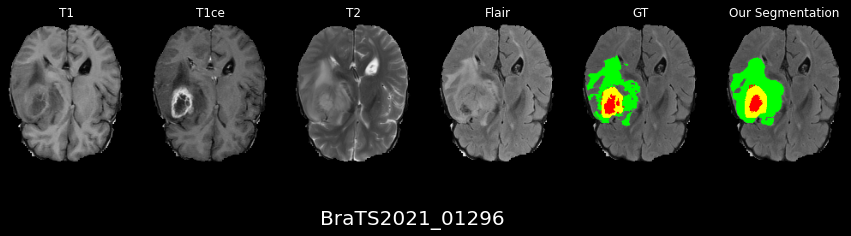

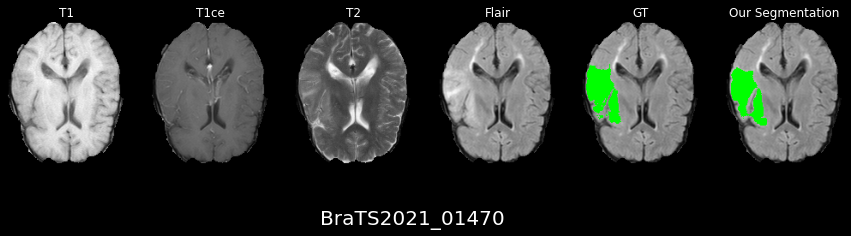

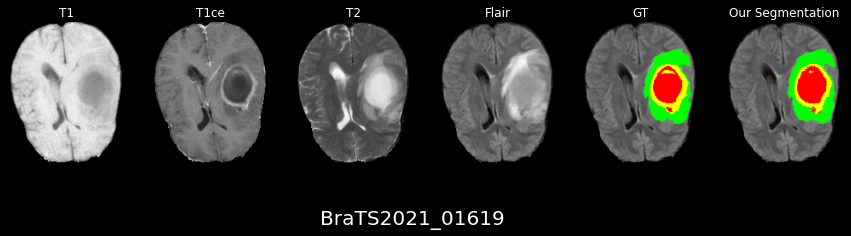

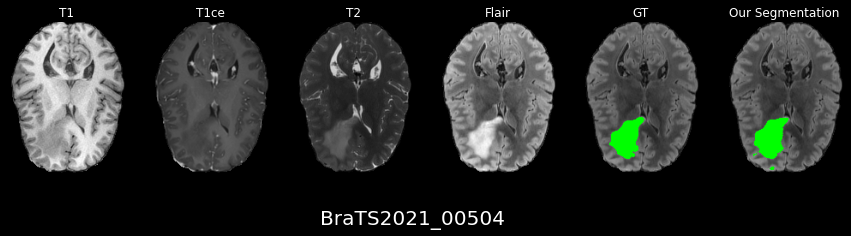

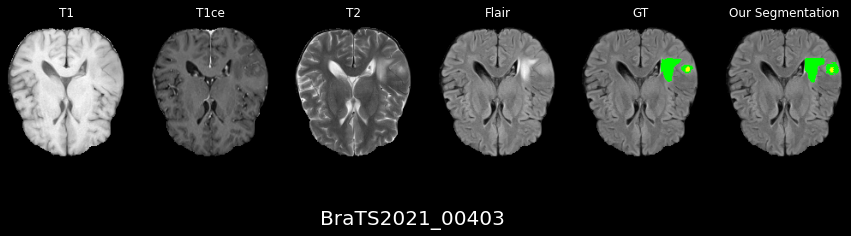

...

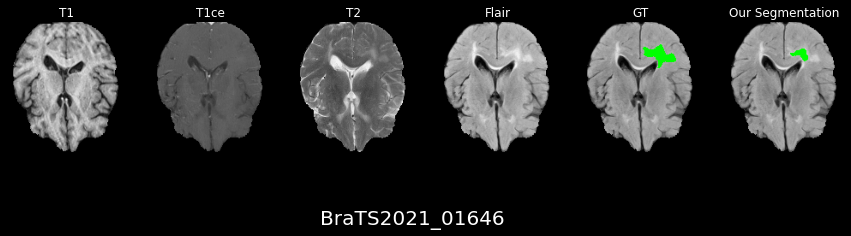

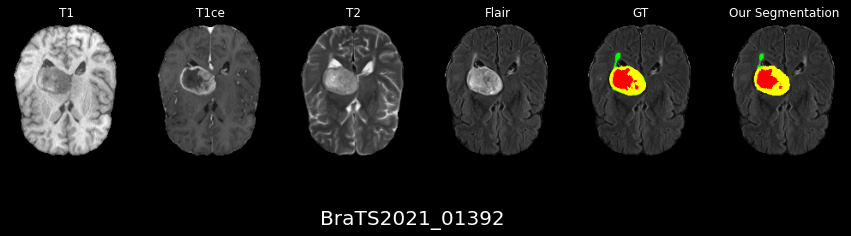

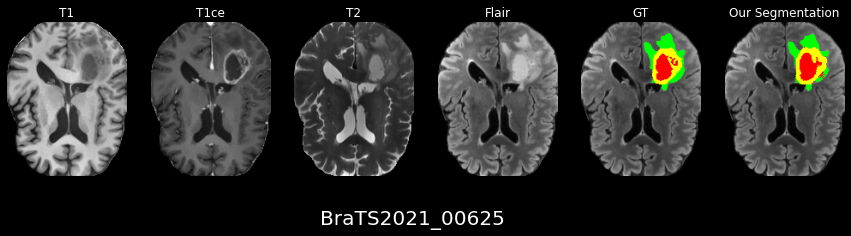

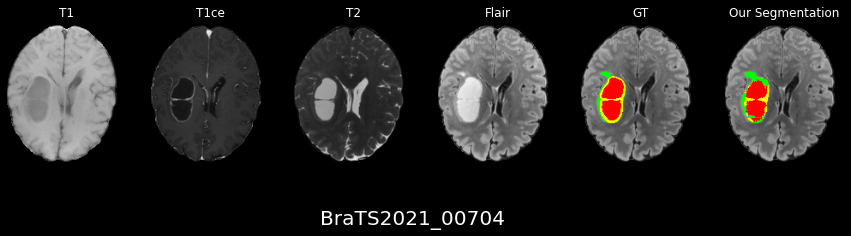

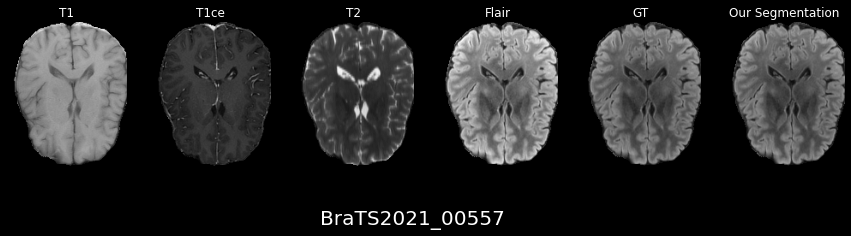

In [26]:
#last loop for metrics
from sklearn.metrics import precision_score
#Importing tqdm function of tqdm module 
from tqdm import tqdm  
from time import sleep 

G = Generator()
# D = Discriminator()

G.load_weights(INPUT_PATH  + '/split_nass_Generator.h5')
# D.load_weights(PATH + f'/{VERSION}_Discriminator.h5')

stats={'dice':[],'spec':[],'sen':[],'hau95':[]}
i=0
# (160,192,128)[40:200,34:226,8:136]
for Xb,yb,Zb in tqdm(valid_gen):
  i=i+1
  print(i)
  for k in range(len(Xb)):
#     visualize(Xb[k,:,:,:,0])
#     break
#     print(Zb[k])
    segG=np.empty((240,240,155,4))
    segG=np.zeros_like(segG)
    segTr=np.empty((240,240,155,4))
    segTr=np.zeros_like(segTr)
    tempy=np.empty((160,192,128,4))
    tempy=np.zeros_like(tempy)
    part1=Xb[k,0:128,0:128,:,:]
    part2=Xb[k,0:128,64:192,:,:]
    part3=Xb[k,32:160,0:128,:,:]
    part4=Xb[k,32:160,64:192,:,:]
    Batch=np.empty((4,128,128,128,4))
    Batch[0,:]=part1
    Batch[1,:]=part2
    Batch[2,:]=part3
    Batch[3,:]=part4
    
    segBatch=G.predict(Batch)
    
    segG1 = segBatch[0,:]
    segG2 = segBatch[1,:]
    segG3 = segBatch[2,:]
    segG4 = segBatch[3,:]
    
    tempy[0:128,0:128,:,:]=segG1
    tempy[0:128,64:192,:,:]=segG2
    tempy[128:160,0:128,:,:]=segG3[96:128,0:128,:,:]
    tempy[128:160,128:192,:,:]=segG4[96:128,64:128,:,:]
 
    segG[40:200,34:226,8:136,:]=tempy
    r = yb[k,:]
    segTr[40:200,34:226,8:136,:]=r
    casepath = Zb[k]
    casepath=casepath[:-9]
    segG_all = np.argmax(segG, axis=-1)
    segTr_all = np.argmax(segTr, axis=-1)
    print(segG_all.shape,segTr_all.shape)
    brainvis(casepath,segG_all)
    dscET=DSC_en(segG_all,segTr_all)
    dscWT=DSC_whole(segG_all,segTr_all)
    dscTC=DSC_core(segG_all,segTr_all)

    specET= specificity_en(segG_all,segTr_all)
    specWT= specificity_whole(segG_all,segTr_all)
    specTC= specificity_core(segG_all,segTr_all)

    senET= sensitivity_en(segG_all,segTr_all)
    senWT= sensitivity_whole(segG_all,segTr_all)
    senTC= sensitivity_core(segG_all,segTr_all)

    hauET= hausdorff_en(segG_all,segTr_all)
    hauWT= hausdorff_whole(segG_all,segTr_all)
    hauTC= hausdorff_core(segG_all,segTr_all)

    stats['dice'].append({'caseID':casepath,'ET':dscET,'WT':dscWT,'TC':dscTC})
    stats['spec'].append({'caseID':casepath,'ET':specET,'WT':specWT,'TC':specTC})
    stats['sen'].append({'caseID':casepath,'ET':senET,'WT':senWT,'TC':senTC})
    stats['hau95'].append({'caseID':casepath,'ET':hauET,'WT':hauWT,'TC':hauTC})

    del(segG,segG_all,segTr,segTr_all)
    

with open(PATH + f'/{VERSION}_stats_{EXEC}.json', 'w') as f:
          json.dump(stats, f, indent=2)
          print("stats saved.")


In [27]:
%%capture cap_metrics --no-stderr
dicewt = []
diceet = []
dicetc = []
senwt = []
senet = []
sentc = []
specwt = []
specet = []
spectc = []
hauwt =[]
hauet = []
hautc = []

# print (stats['dice'][0]['WT'])
for k in range(len(valid_gen)*BATCH_SIZE):
  dicewt.append(stats['dice'][k]['WT'])
  diceet.append(stats['dice'][k]['ET'])
  dicetc.append(stats['dice'][k]['TC'])
  senwt.append(stats['sen'][k]['WT'])
  senet.append(stats['sen'][k]['ET'])
  sentc.append( stats['sen'][k]['TC'])
  specwt.append(stats['spec'][k]['WT'])
  specet.append(stats['spec'][k]['ET'])
  spectc.append(stats['spec'][k]['TC'])
  hauwt.append(stats['hau95'][k]['WT'])
  hauet.append(stats['hau95'][k]['ET'])
  hautc.append( stats['hau95'][k]['TC'])
    
print('Dice WT: ',np.mean(dicewt))
print('Dice ET: ',np.mean(diceet))
print('Dice TC: ',np.mean(dicetc))

print('Sen WT: ',np.mean(senwt))
print('Sen ET: ',np.mean(senet))
print('Sen TC: ',np.mean(sentc))

print('Spec WT: ',np.mean(specwt))
print('Spec ET: ',np.mean(specet))
print('Spec TC: ',np.mean(spectc))

print('Hau95 WT: ',np.mean(hauwt))
print('Hau95 ET: ',np.mean(hauet))
print('Hau95 TC: ',np.mean(hautc))


In [28]:
with open(PATH + f'/{VERSION}_metrics_{EXEC}.txt', 'w') as f:
    f.write(cap_metrics.stdout)

In [29]:
! zip -r './results.zip' {PATH+'/*'}

  adding: RESULTS/eval_brats21_h_1.txt (stored 0%)
  adding: RESULTS/eval_brats21_metrics_1.txt (deflated 46%)
  adding: RESULTS/eval_brats21_stats_1.json (deflated 81%)


In [30]:
from IPython.display import FileLink
FileLink(r'./results.zip')
# then in colab : !wget "https://....kaggle.net/...../results.zip"

/kaggle/working/results.zip

In [31]:
# # NON

# # Define a function to visualize the data
# def explore_3dimage(channel,x_layer,y_layer,z_layer):
#     plt.figure(figsize=(15, 15))
   
#     plt.subplot(1,6,1)
#     plt.imshow(image_data[x_layer, :, :, channel], cmap='gray');
#     plt.title('Sagital', fontsize=15)
#     # plt.axis('off')
#     plt.subplot(1,6,2)
#     plt.imshow(image_data[:, y_layer, :, channel], cmap='gray');
#     plt.title('Coronal', fontsize=15)
#     # plt.axis('off')
#     plt.subplot(1,6,3)
#     plt.imshow(image_data[:, :, z_layer, channel], cmap='gray');
#     plt.title('Axial', fontsize=15)
#     # plt.axis('off')
#     plt.subplot(1,6,4)
#     plt.imshow(label_array[x_layer, :, :]);
#     plt.title('Seg Sagital', fontsize=15)
#     # plt.axis('off')
#     plt.subplot(1,6,5)
#     plt.imshow(label_array[:, y_layer, :]);
#     plt.title('Seg Coronal', fontsize=15)
#     # plt.axis('off')
#     plt.subplot(1,6,6)
#     plt.imshow(label_array[:, :, z_layer]);
#     plt.title('Seg Axial', fontsize=15)
#     # plt.axis('off')
    
#     # plt.subplots_adjust(wspace=0, hspace=0)
    


In [32]:
# #visualisation des axes
# def visualize(X):
#     """
#     Visualize the image middle slices for each axis
#     """
#     a,b,c = X.shape
    
#     plt.figure(figsize=(15,15))
#     plt.subplot(131)
#     plt.imshow(np.rot90(X[a//2, :, :]), cmap='gray')
#     plt.axis('off')
#     plt.subplot(132)
#     plt.imshow(np.rot90(X[:, b//2, :]), cmap='gray')
#     plt.axis('off')
#     plt.subplot(133)
#     plt.imshow(X[:, :, c//2], cmap='gray')
#     plt.axis('off')